<a href="https://colab.research.google.com/github/visualdatabase/fastdup/blob/main/examples/UAV_Drone_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [13]:
!gdown 1m8KA6oPIRK_Iwt9TYFquC87vBc_8wRVc

Downloading...
From: https://drive.google.com/uc?id=1m8KA6oPIRK_Iwt9TYFquC87vBc_8wRVc
To: /content/UAV-benchmark-M.zip
100% 6.79G/6.79G [00:45<00:00, 149MB/s]


In [14]:
!gdown 19498uJd7T9w4quwnQEy62nibt3uyT9pq

Downloading...
From: https://drive.google.com/uc?id=19498uJd7T9w4quwnQEy62nibt3uyT9pq
To: /content/UAV-benchmark-MOTD_v1.0.zip
100% 246M/246M [00:01<00:00, 207MB/s]


In [15]:
!gdown 1qjipvuk3XE3qU3udluQRRcYuiKzhMXB1

Downloading...
From: https://drive.google.com/uc?id=1qjipvuk3XE3qU3udluQRRcYuiKzhMXB1
To: /content/M_attr.zip
100% 9.50k/9.50k [00:00<00:00, 14.0MB/s]


In [ ]:
!unzip /content/UAV-benchmark-M.zip

In [ ]:
!unzip /content/M_attr.zip

In [19]:
!cat M_attr/readme.txt  

The format of the sequence-level attributes for each sequence is set as
daylight, night, fog; low-alt, medium-alt, high-alt; front-view, side-view,	bird-view; long-term.


In [ ]:
!unzip /content/UAV-benchmark-MOTD_v1.0.zip

In [24]:
!cat UAV-benchmark-MOTD_v1.0/README.md

This code library is for research purpose only, which is modifed based on the Milan et al.:
[1] A. Milan, L. Leal-Taix��, I. D. Reid, S., and K. Schindler. MOT16: A Benchmark for Multi-Object Tracking, in CoRR abs/1603.00831, 2016.

We distribute our library under the GNU-GPL license. If you use this library or the dataset, please cite our paper:
[2] D. Du, Y. Qi, H. Yu, Y. Yang, K. Duan, G. Li, W. Zhang, Q. Huang, and Q. Tian. The Unmanned Aerial Vehicle Benchmark: Object Detection and Tracking, in ECCV, 2018. 

The project website is https://sites.google.com/site/daviddo0323/ and the library will be updated on it.
If you have any questions, please contact us (email:cvdaviddo@gmail.com).

function CalculateTrakingAcc is used for evaluating the MOT methods
function CalculateDetectionsPR is used for evaluating the detection methods

MOT Groundtruth Format(*_gt.txt)

It looks as follows:

        <frame_index>,<target_id>,<bbox_left>,<bbox_top>,<bbox_width>,<bbox_height>,<score>,<in-view

In [28]:
import pandas as pd
ann = pd.read_csv('./UAV-benchmark-MOTD_v1.0/GT/M0606_gt_whole.txt', header=None)
ann.columns = ['frame_id','target_id','bbox_l','bbox_t','bbox_w','bbox_h', 'out_of_view','occlusion','cat']

In [29]:
ann.head()

,frame_id,target_id,bbox_l,bbox_t,bbox_w,bbox_h,out_of_view,occlusion,cat
0,723,1,539,214,15,14,1,1,1
1,724,1,538,214,15,14,1,1,1
2,725,1,538,215,15,14,1,1,1
3,726,1,538,216,15,14,1,1,1
4,727,1,538,217,15,14,1,1,1


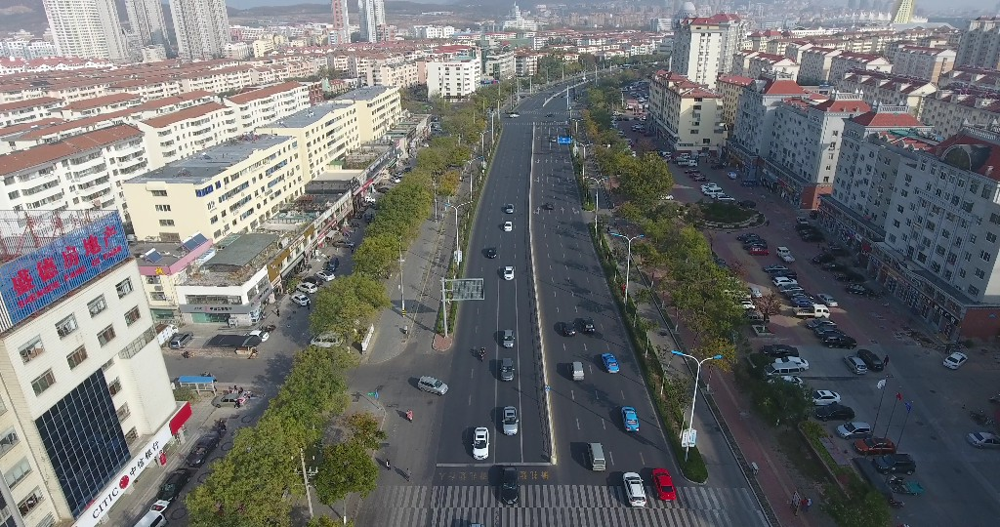

In [33]:
from IPython.display import Image
Image('./UAV-benchmark-M/M0606/img000275.jpg')

In [104]:
frame25 = ann[ann['frame_id'] == 275]

In [137]:
from PIL import Image
import os
import cv2
import numpy as np
from tqdm import tqdm
 

In [152]:
!rm -fr output
!mkdir -p output

for video in os.listdir(f'./UAV-benchmark-M/'):
  for f in tqdm(os.listdir(f'./UAV-benchmark-M/{video}/')):
    img = cv2.imread(f'./UAV-benchmark-M/{video}/{f}')
    frame_int = int(f.replace('.jpg','').replace('img',''))
    subdf = ann[ann['frame_id'] == frame_int]
    for i in range(len(subdf)):
      row = subdf.values[i]
      target = row[1]
      top = row[2] #L
      left = row[3] #T
      width = row[4] #W
      height = row[5] #H
      img_array = np.array(img)
      w,h = img_array.shape[0], img_array.shape[1]
      try:
        ret = img_array[max(left-5,0):min(left+width+5,w),max(top-5,0):min(top+height+5,h)]
        cropped = Image.fromarray(ret)
        cropped.save(f'output/{video}_{frame}_{i}_{target}.jpg')
      except:
        print('Failed on row', row, w, h)

 31%|███       | 588/1906 [00:09<00:21, 60.62it/s]

Failed on row [849  21 980 494  34  27   1   4   1] 540 960


 32%|███▏      | 609/1906 [00:10<00:21, 59.02it/s]

Failed on row [848  21 973 492  36  26   1   4   1] 540 960


 66%|██████▌   | 1262/1906 [00:22<00:11, 54.33it/s]

Failed on row [847  21 967 490  37  25   1   4   1] 540 960


100%|██████████| 445/445 [00:11<00:00, 39.46it/s]


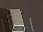

In [120]:
import IPython
IPython.display.Image('crop.png')

In [153]:
!pip install fastdup
import fastdup
!python -c "import fastdup; fastdup.run('output', work_dir='result',turi_param='ccthreshold=0.9')"

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
On Jupyter notebook running on large datasets, there may be delay getting the console output. We recommend running using python shell.
Going to loop over dir output
Found total 21876 images to run on
Wrote total of 21876 features atrain_, found 0 bad images
Found total 21876 images to run on
11) Finished write_index() faiss
Stored faiss index file result/faiss.index
1656081040 : INFO:     (add_vertices:460): Num vertices for group 0: 21876
1656081040 : INFO:     (commit_edge_buffer:609): In commit edge buffer (0,0)
1656081040 : INFO:     (commit_edge_buffer:680): Shuffling edges ...
1656081040 : INFO:     (commit_edge_buffer:688): Done shuffling edges in 0.030106 secs
1656081040 : INFO:     (commit_edge_buffer:692): Aggregating unique vertices...
1656081040 : INFO:     (commit_edge_buffer:705): Done aggregating uni

In [148]:
!ls result

atrain_features.dat	 component_info.csv	   faiss.index	 similarity.csv
atrain_features.dat.csv  connected_components.csv  outliers.csv


In [154]:
fastdup.create_components_gallery('result','.')

100%|██████████| 20/20 [00:04<00:00,  4.59it/s]


Finished OK. Components are stored as image files components{i}.png


100%|██████████| 20/20 [00:00<00:00, 63.63it/s]


Stored components visual view in  ./components.html


<Figure size 432x288 with 0 Axes>

,component_id,num_images,image
0,2680,15752,
1,1894,39,
2,333,19,
3,9574,19,
4,189,18,
5,518,16,
6,2531,16,
7,10881,15,
8,1636,15,
9,9948,15,

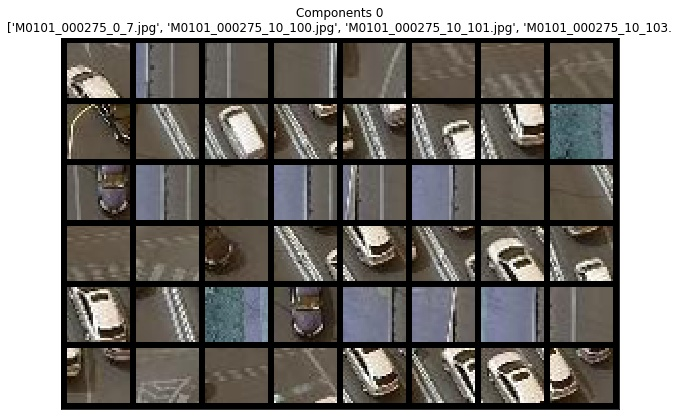
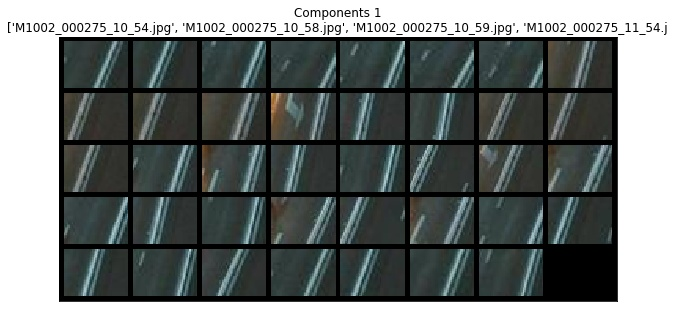
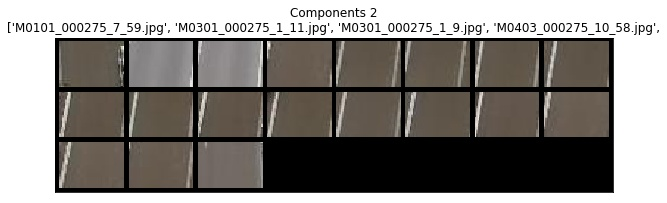
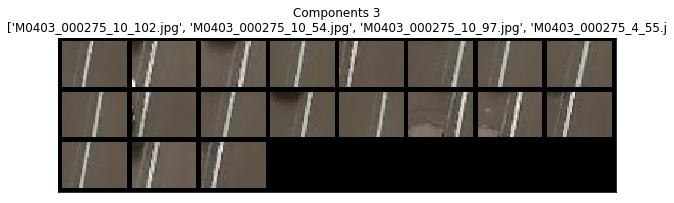
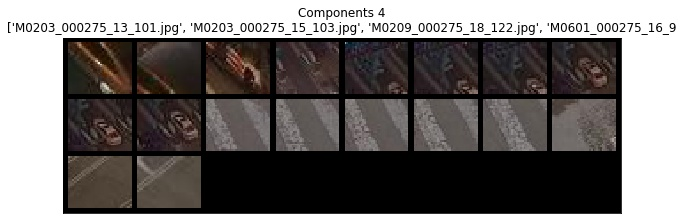
...
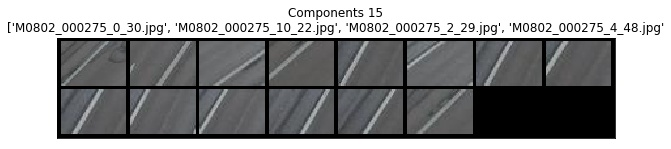
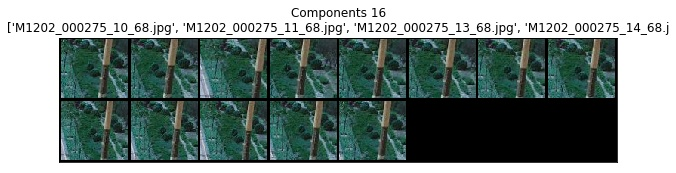
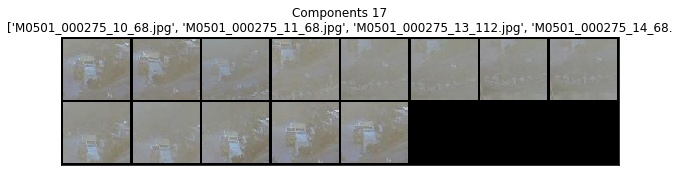
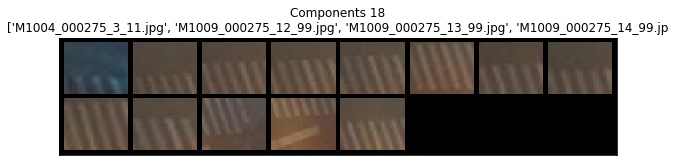
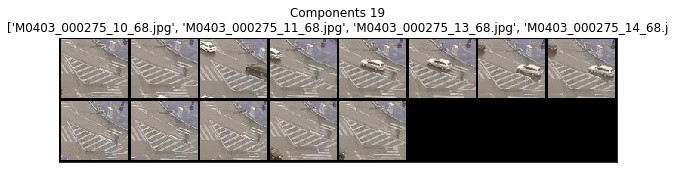

In [155]:
from IPython.display import HTML
HTML('./components.html')

In [164]:
outliers = pd.read_csv('result/outliers.csv')
outliers = outliers.tail(100)
outliers.to_csv('outliers.csv')
fastdup.create_outliers_gallery('outliers.csv','.', num_images=100)

100%|██████████| 67/67 [00:00<00:00, 612.47it/s]


Stored outliers visual view in  ./outliers.html


,Image,Distance,Path
99,,0.588282,output/M0203_000275_20_69.jpg
98,,0.632216,output/M0203_000275_19_69.jpg
97,,0.651621,output/M0202_000275_14_69.jpg
96,,0.663152,output/M1003_000275_9_112.jpg
93,,0.670532,output/M1003_000275_12_112.jpg
92,,0.671483,output/M1401_000275_12_112.jpg
91,,0.677831,output/M0203_000275_5_68.jpg
90,,0.679175,output/M1008_000275_4_41.jpg
89,,0.679412,output/M0602_000275_9_112.jpg
87,,0.684063,output/M1003_000275_12_68.jpg

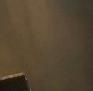
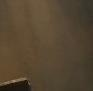
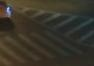
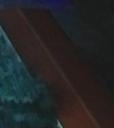
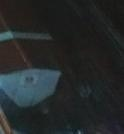
...
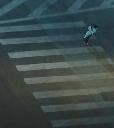
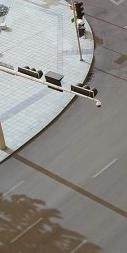
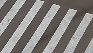
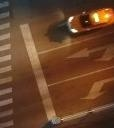
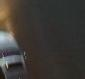

In [165]:
HTML('./outliers.html')

In [158]:
!tail result/outliers.csv

output/M1008_000275_4_41.jpg,output/M0801_000275_1_7.jpg,0.679175
output/M0203_000275_5_68.jpg,output/M0205_000275_19_69.jpg,0.677831
output/M1401_000275_12_112.jpg,output/M1401_000275_3_19.jpg,0.671483
output/M1003_000275_12_112.jpg,output/M1001_000275_11_112.jpg,0.670532
output/M0202_000275_14_69.jpg,output/M0202_000275_20_69.jpg,0.669353
output/M1003_000275_9_112.jpg,output/M1001_000275_7_19.jpg,0.668147
output/M1003_000275_9_112.jpg,output/M1003_000275_7_71.jpg,0.663152
output/M0202_000275_14_69.jpg,output/M0202_000275_13_69.jpg,0.651621
output/M0203_000275_19_69.jpg,output/M0208_000275_6_59.jpg,0.632216
output/M0203_000275_20_69.jpg,output/M0604_000275_1_30.jpg,0.588282


In [168]:
fastdup.create_duplicates_gallery('result/similarity.csv','.')

100%|██████████| 20/20 [00:00<00:00, 121.58it/s]


Stored similarity visual view in  ./similarity.html


,Image,Distance,From,To
0,,0.999893,output/M0603_000275_8_84.jpg,output/M0603_000275_0_67.jpg
2,,0.999469,output/M0603_000275_14_95.jpg,output/M0603_000275_15_95.jpg
4,,0.999413,output/M0701_000275_10_122.jpg,output/M0701_000275_16_122.jpg
6,,0.999299,output/M0701_000275_5_14.jpg,output/M0701_000275_12_19.jpg
8,,0.999288,output/M0603_000275_19_95.jpg,output/M0603_000275_20_95.jpg
10,,0.999274,output/M0603_000275_5_42.jpg,output/M0603_000275_18_119.jpg
12,,0.999236,output/M0701_000275_5_14.jpg,output/M0701_000275_16_122.jpg
14,,0.999211,output/M0701_000275_5_28.jpg,output/M0603_000275_19_95.jpg
16,,0.999180,output/M0701_000275_12_19.jpg,output/M0701_000275_5_21.jpg
18,,0.999170,output/M0603_000275_8_84.jpg,output/M0603_000275_5_42.jpg

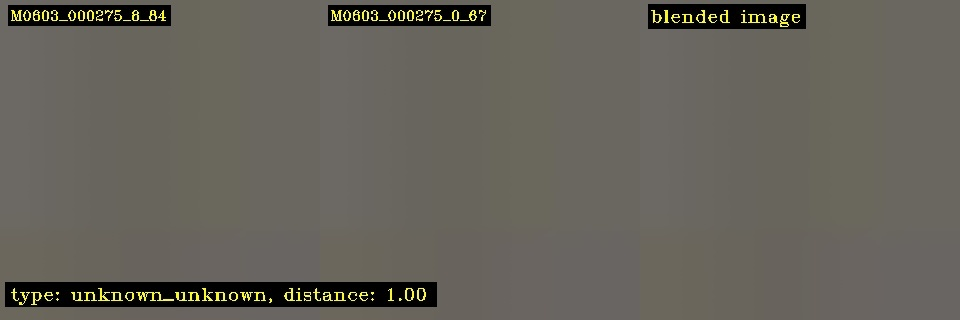
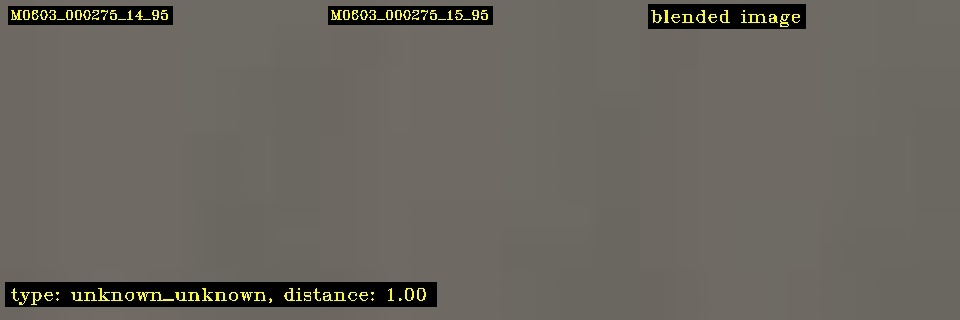
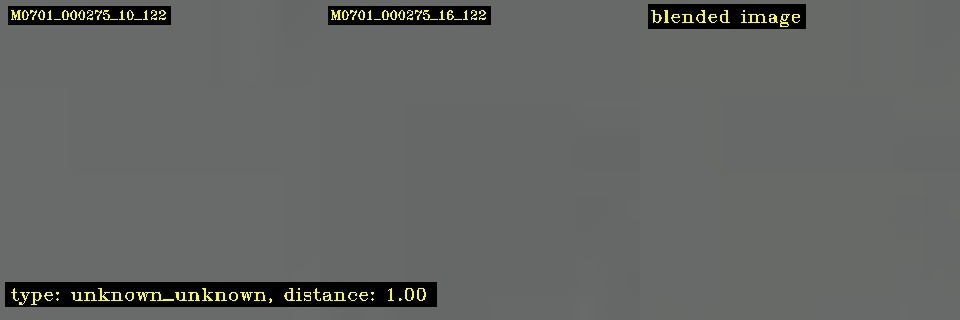
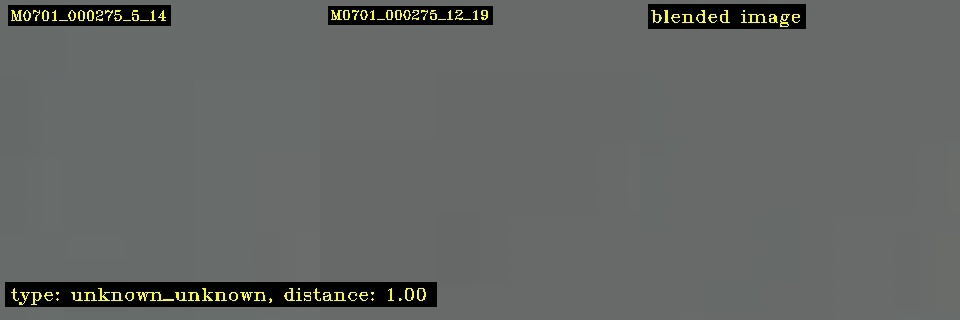
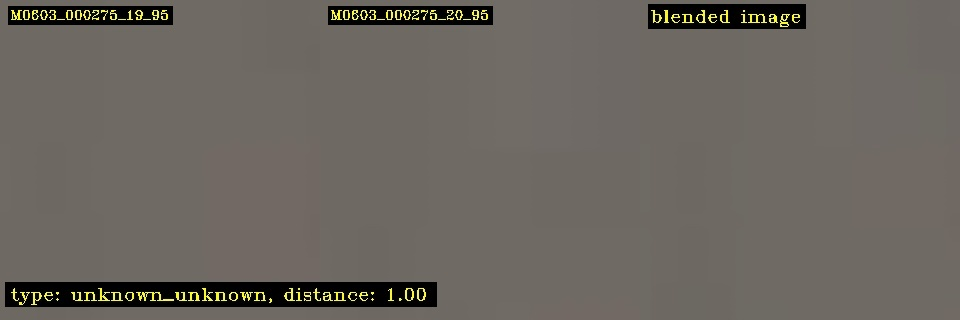
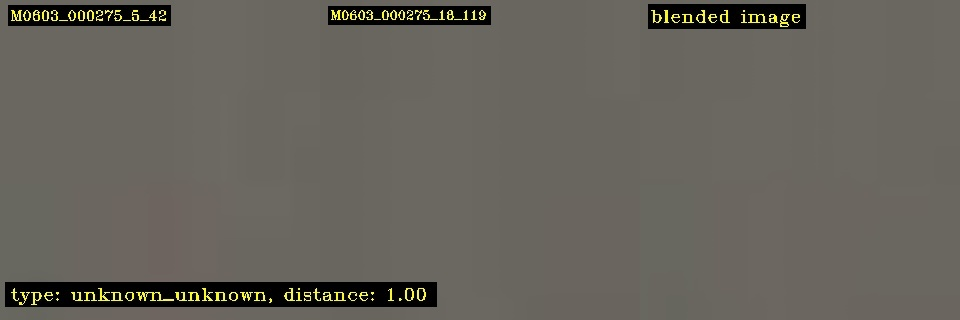
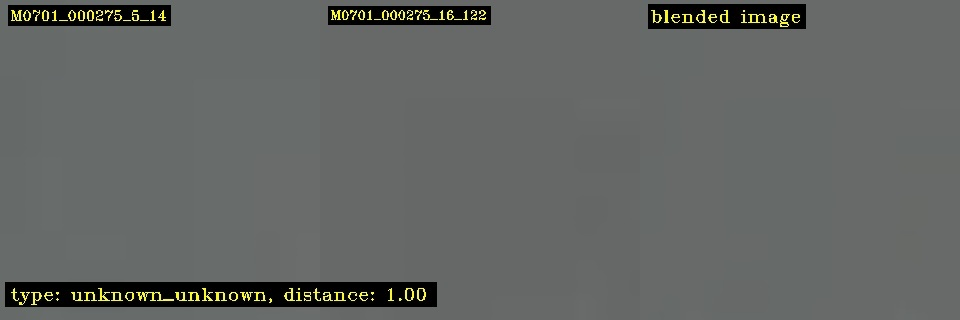
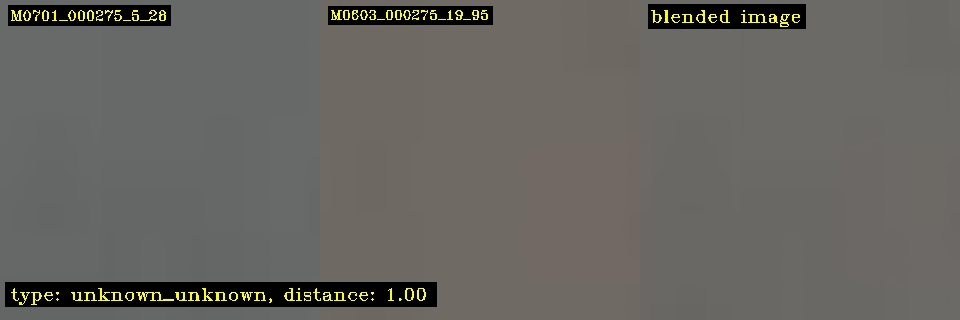
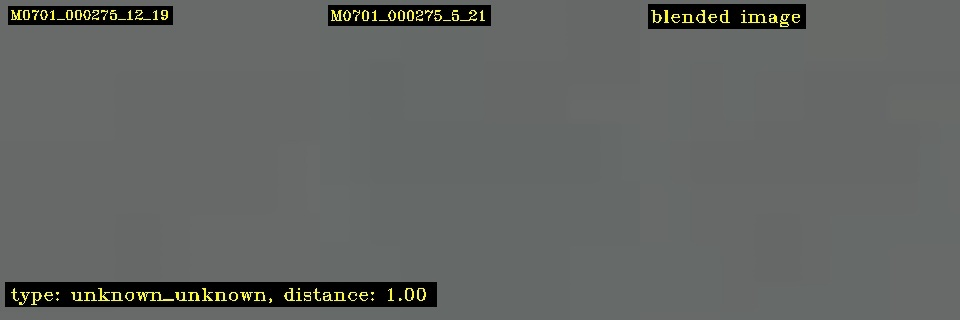
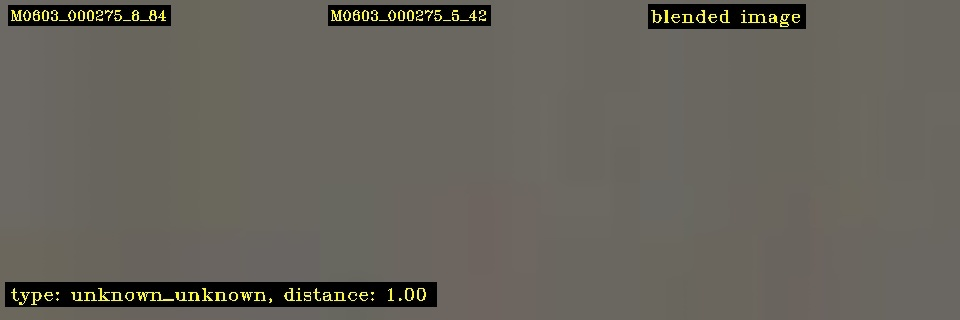

In [170]:
HTML('similarity.html')

In [171]:
fastdup.export_to_tensorboard_projector('result','log') 

Read a total of  21876 images


100%|██████████| 900/900 [00:04<00:00, 223.57it/s]


Finish exporting to tensorboard projector, now run
%load_ext tensorboard
%tensorboard --logdir=log


In [173]:
%load_ext tensorboard
%tensorboard --logdir=log

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1632), started 0:00:20 ago. (Use '!kill 1632' to kill it.)

<IPython.core.display.Javascript object>